## **1. 데이터 준비하기(Custom Data 구축)**
- Roboflow에서 제공하는 Training Dataset을 이용

### 1) Roboflow 에서 Aquarium Dataset (custom data) 다운로드
- Public Dataset : https://public.roboflow.com/object-detection/aquarium/2
- Download Dataset > Export - Select Format : Yolov8, show download code 선택 후  continue 버튼 클릭 > Your Download Code - Raw URL 탭에서 주조 복사하기

In [1]:
!type .\CigaretteButtDetector.v5i.yolov8\data.yaml

names:
- cig_butt
- burn_butt
nc: 2
test: C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/test/images
train: C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/train/images
val: C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/valid/images


In [2]:
import os
print(os.getcwd())

C:\Users\USER\Documents\vision-AI\project\7899


In [3]:
# yaml 파일을 학습이 가능하도록 경로 설정.
# key-value 데이터인 dict 데이터타입으로 data['train'], data['val'], data['nc'], data['names'] 에 넣어주는데,
# 가장 중요한 부분은 데이터 경로 설정임.

import yaml
# 디렉토리 정보, 클래스 이름(names), 클래스 수(nc) 지정하기

# window - 절대경로 사용
data = {
    'train': 'C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/train/images',
    'val': 'C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/valid/images',
    'test': 'C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/test/images',

    'names':['cig_butt', 'burn_butt'],
    'nc': 2
}

# 데이터 경로와 클래스 정보를 저장하고 있는 딕셔너리 객체 data를 YOLOv8 학습에 필요한 새로운 이름으로 저장
with open('./CigaretteButtDetector.v5i.yolov8/data.yaml', 'w') as f:
  yaml.dump(data, f)

# Aquarium_Data.yaml 읽어서 화면에 출력
with open('./CigaretteButtDetector.v5i.yolov8/data.yaml', 'r') as f:
  aquarium_yaml = yaml.safe_load(f)
  display(aquarium_yaml)

{'names': ['cig_butt', 'burn_butt'],
 'nc': 2,
 'test': 'C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/test/images',
 'train': 'C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/train/images',
 'val': 'C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/valid/images'}

In [4]:
!type .\CigaretteButtDetector.v5i.yolov8\data.yaml

names:
- cig_butt
- burn_butt
nc: 2
test: C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/test/images
train: C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/train/images
val: C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/valid/images


## **2. yolov8 사용을 위한 패키지 설치 및 가져오기**
- https://github.com/ultralytics/ultralytics

In [5]:
import torch

if torch.cuda.is_available():
    print(f"GPU is available: {torch.cuda.get_device_name(0)}")
else:
    print("GPU is not available.")

GPU is available: NVIDIA GeForce RTX 4060


In [6]:
# 패키지 버전 확인하기
import ultralytics

ultralytics.checks()

Ultralytics YOLOv8.2.11  Python-3.10.14 torch-2.3.0 CUDA:0 (NVIDIA GeForce RTX 4060, 8188MiB)
Setup complete  (24 CPUs, 31.7 GB RAM, 253.1/953.0 GB disk)


## **3.모델 객체 선언하고 학습하기**

### 1) 모델 객체 선언하기

In [7]:
from ultralytics import YOLO

model = YOLO('yolov8n.pt')  # 사전학습된 YOLOv8n detection model 로드하기.

In [8]:
import torch
print(torch.cuda.is_available())
print(torch.cuda.get_device_name(0))

True
NVIDIA GeForce RTX 4060


### 2) 모델 학습하기 (자신의 만든 yaml파일 지정)

1. **`data`**: 데이터셋 설정 파일의 로드. YAML 형식의 파일로, 훈련, 검증, 테스트 데이터 경로 및 클래스수
2. **`epochs`**: 훈련에 사용할 총 에포크 수
3. **`patience`**: 모델 학습 중 개선이 없을 때 학습을 중단하기 전에 기다리는 에포크 지정
4. **`batch`**: 각 훈련 스텝에서 처리할 이미수 있습니다.
5. **`imgsz`**: 입 이미(도를 정의합니다. 일반적으로 416, 512, 640) 이 사용됩니다.
6. **`optimizer`**: 사용할 (고리즘을 지정합니다. 일반적으로 `SGD`, `Adam`, `AdamW)은옵션을 사용합니다.
7. **`momentum`**: 모멘텀 지정
8. **`weight_decay`**: 가중치 감적합을 방지하는 데 사용됩니다.
9. **`warmup_epochs`**: 초기 학습률을높이기사퓨1의 코어 수에 따라 최적화하세요.
10. **`save` : 모델을 저장할지 여부를 결정합니다.


In [9]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [10]:
# 모델 학습하기 (자신의 만든 yaml파일 지정)
model.train(data='C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/data.yaml', epochs=10000, patience=10, batch=32, imgsz=640)

New https://pypi.org/project/ultralytics/8.2.15 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.2.11  Python-3.10.14 torch-2.3.0 CUDA:0 (NVIDIA GeForce RTX 4060, 8188MiB)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/data.yaml, epochs=10000, time=None, patience=10, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train13, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms

C:\Users\USER\anaconda3\envs\torch-gpu\lib\site-packages\torch\nn\modules\conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\cudnn\Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


AMP: checks passed 


train: Scanning C:\Users\USER\Documents\vision-AI\project\7899\CigaretteButtDetector.v5i.yolov8\train\labels.cache... 7

WARNING  Box and segment counts should be equal, but got len(segments) = 1830, len(boxes) = 7029. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.



val: Scanning C:\Users\USER\Documents\vision-AI\project\7899\CigaretteButtDetector.v5i.yolov8\valid\labels.cache... 158

WARNING  Box and segment counts should be equal, but got len(segments) = 408, len(boxes) = 1581. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


Plotting labels to runs\detect\train13\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs\detect\train13
Starting training for 10000 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    1/10000      4.67G      1.262      2.616      1.215         36        640: 100%|██████████| 220/220 [00:54<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:13


                   all       1581       1581      0.585      0.457      0.486      0.334

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    2/10000      4.31G      1.181      1.587      1.175         34        640: 100%|██████████| 220/220 [00:50<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:11


                   all       1581       1581      0.508      0.494      0.476      0.331

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    3/10000       4.3G      1.227      1.349      1.216         37        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08


                   all       1581       1581      0.492       0.41      0.398      0.257

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    4/10000       4.3G      1.281      1.268      1.266         30        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.736      0.392      0.413      0.269



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    5/10000       4.3G      1.243      1.177      1.257         28        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581       0.41      0.482      0.444      0.297



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    6/10000       4.3G      1.214       1.12      1.253         28        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.477      0.568      0.503      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    7/10000       4.3G      1.174      1.065      1.223         28        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.443       0.43      0.416      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    8/10000       4.3G      1.128      1.019      1.194         45        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.445      0.563      0.512      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    9/10000       4.3G      1.118     0.9901      1.193         26        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.492      0.537      0.532      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   10/10000       4.3G        1.1     0.9689      1.182         36        640: 100%|██████████| 220/220 [00:49<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581       0.52      0.615      0.579       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   11/10000       4.3G      1.069     0.9293      1.163         27        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.513      0.599       0.55       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   12/10000       4.3G      1.069     0.9252      1.166         28        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.458      0.545      0.534      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   13/10000       4.3G      1.059     0.9051      1.159         38        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09

                   all       1581       1581      0.536      0.638        0.6      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   14/10000       4.3G      1.038      0.881      1.146         27        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09

                   all       1581       1581      0.676      0.504      0.573      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   15/10000       4.3G      1.027     0.8594      1.146         31        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.612      0.632      0.627      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   16/10000       4.3G      1.017      0.861      1.142         35        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.563      0.621      0.614      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   17/10000       4.3G       1.01     0.8389       1.13         30        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.685      0.646      0.651      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   18/10000       4.3G      1.002     0.8307      1.131         38        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.636      0.619      0.643      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   19/10000       4.3G     0.9864     0.8168      1.121         36        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:07

                   all       1581       1581      0.634      0.627      0.636      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   20/10000       4.3G     0.9931     0.8159      1.124         34        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.575      0.669      0.634      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   21/10000       4.3G     0.9716     0.8036       1.11         29        640: 100%|██████████| 220/220 [00:49<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.639      0.667      0.653      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   22/10000       4.3G     0.9699     0.7855      1.108         33        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09

                   all       1581       1581      0.654      0.693      0.665       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   23/10000       4.3G     0.9659     0.7795      1.101         38        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.651      0.692      0.682      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   24/10000       4.3G     0.9569     0.7612      1.101         36        640: 100%|██████████| 220/220 [00:49<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.734      0.642      0.698      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   25/10000       4.3G     0.9548     0.7677        1.1         42        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581       0.66      0.638      0.651      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   26/10000       4.3G     0.9516     0.7739      1.096         26        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.666      0.633      0.657      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   27/10000       4.3G     0.9393     0.7477      1.092         31        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.646      0.681       0.69       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   28/10000       4.3G     0.9431      0.749      1.091         42        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.706      0.756      0.725      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   29/10000       4.3G      0.927      0.734      1.088         23        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.707      0.715       0.73      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   30/10000       4.3G     0.9435     0.7488      1.095         30        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.649       0.69      0.677      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   31/10000       4.3G     0.9313     0.7242      1.083         41        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09

                   all       1581       1581      0.659      0.737      0.705      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   32/10000       4.3G     0.9203     0.7169      1.078         34        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.635      0.655      0.667       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   33/10000       4.3G     0.9341     0.7261      1.085         27        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.658      0.693      0.691      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   34/10000       4.3G     0.9205     0.7259      1.086         36        640: 100%|██████████| 220/220 [00:49<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.679      0.745      0.702      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   35/10000       4.3G      0.909     0.7094      1.078         42        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.727      0.719      0.755      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   36/10000       4.3G     0.9178      0.705      1.077         29        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.752      0.645      0.719      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   37/10000       4.3G     0.9129     0.7046      1.074         31        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581       0.79      0.704      0.743      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   38/10000       4.3G     0.9037     0.6956      1.074         30        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.659      0.668      0.664      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   39/10000       4.3G     0.9013     0.7018      1.072         35        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.678      0.693      0.705        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   40/10000       4.3G     0.9019     0.6951      1.072         36        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09

                   all       1581       1581      0.717      0.677      0.716      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   41/10000       4.3G     0.8931     0.6871       1.06         32        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09

                   all       1581       1581      0.709      0.727      0.738      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   42/10000       4.3G     0.8902     0.6824      1.063         27        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.756      0.699      0.745       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   43/10000       4.3G     0.8768     0.6671      1.053         33        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.761      0.695      0.741      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   44/10000       4.3G     0.8838      0.675      1.056         32        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.689       0.72      0.704        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   45/10000       4.3G     0.8853     0.6727      1.055         39        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.789      0.704      0.761       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   46/10000       4.3G     0.8868     0.6735      1.063         31        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.676      0.716      0.703      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   47/10000       4.3G     0.8806     0.6718      1.055         21        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09

                   all       1581       1581      0.696      0.726       0.73      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   48/10000       4.3G     0.8793     0.6604      1.057         29        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.709      0.738      0.743      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   49/10000       4.3G     0.8753     0.6569      1.051         39        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.765      0.737      0.764      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   50/10000       4.3G     0.8663     0.6514       1.05         30        640: 100%|██████████| 220/220 [00:47<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.704      0.732      0.735       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   51/10000       4.3G     0.8811     0.6548      1.054         27        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.676      0.773      0.741      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   52/10000       4.3G     0.8668     0.6578      1.049         35        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.673      0.754      0.745      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   53/10000       4.3G     0.8693     0.6538      1.048         26        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.712      0.755      0.754      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   54/10000       4.3G      0.864     0.6362      1.043         34        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08

                   all       1581       1581      0.724      0.734      0.742      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   55/10000       4.3G     0.8559     0.6324      1.043         23        640: 100%|██████████| 220/220 [00:48<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09

                   all       1581       1581      0.768      0.725      0.759      0.518
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 45, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



55 epochs completed in 0.884 hours.
Optimizer stripped from runs\detect\train13\weights\last.pt, 6.3MB
Optimizer stripped from runs\detect\train13\weights\best.pt, 6.3MB

Validating runs\detect\train13\weights\best.pt...
Ultralytics YOLOv8.2.11  Python-3.10.14 torch-2.3.0 CUDA:0 (NVIDIA GeForce RTX 4060, 8188MiB)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10


                   all       1581       1581      0.761      0.709       0.76       0.53
              cig_butt       1581       1442      0.896      0.942      0.964      0.816
             burn_butt       1581        139      0.625      0.475      0.557      0.244
Speed: 0.2ms preprocess, 1.5ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs\detect\train13


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000002AAA2837070>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

In [11]:
# 커스텀 데이터로 학습하였기 때문에 클래수 수의 변경됨을 확인할 수 있음
print(type(model.names), len(model.names))
print(model.names)

<class 'dict'> 2
{0: 'cig_butt', 1: 'burn_butt'}


### ▲ train 과정중에 loss, accuracy 등의 graph 데이터는 runs/detect/train/ 에 있는 results.csv 와 results.png 통해서 확인가능함

## **3.객체 검출 (Inference or predict)**

In [12]:
results = model.predict(source='C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/test/images/', save=True)


image 1/789 C:\Users\USER\Documents\vision-AI\project\7899\CigaretteButtDetector.v5i.yolov8\test\images\00000004_jpg.rf.74dee18d774827df5917e084fb7e459d.jpg: 640x640 1 cig_butt, 8.0ms
image 2/789 C:\Users\USER\Documents\vision-AI\project\7899\CigaretteButtDetector.v5i.yolov8\test\images\00000005_jpg.rf.240d11b8078fc391a3f83985aafe076c.jpg: 640x640 1 cig_butt, 8.1ms
image 3/789 C:\Users\USER\Documents\vision-AI\project\7899\CigaretteButtDetector.v5i.yolov8\test\images\00000010_jpg.rf.1d19a4889598d8710b68a3fdd1d1a31b.jpg: 640x640 1 cig_butt, 8.3ms
image 4/789 C:\Users\USER\Documents\vision-AI\project\7899\CigaretteButtDetector.v5i.yolov8\test\images\00000020_jpg.rf.b4e1c978680512c71dabd6cba34d741c.jpg: 640x640 1 cig_butt, 8.2ms
image 5/789 C:\Users\USER\Documents\vision-AI\project\7899\CigaretteButtDetector.v5i.yolov8\test\images\00000038_jpg.rf.1468bb71eaced4dc7ada6fe83229248d.jpg: 640x640 1 cig_butt, 8.0ms
image 6/789 C:\Users\USER\Documents\vision-AI\project\7899\CigaretteButtDetecto

## **5. 결과 확인하기**

In [19]:
print(type(results), len(results))

<class 'list'> 789


In [25]:
import numpy as np

for result in results:
    uniq, cnt = np.unique(result.boxes.cls.cpu().numpy(), return_counts=True)  # Torch.Tensor -> numpy
    uniq_cnt_dict = dict(zip(uniq, cnt))

    print('\n{class num : counts} =', uniq_cnt_dict,'\n')

    for i, c in enumerate(result.boxes.cls):
        class_id = int(c)
        class_name = result.names[class_id]
        confidence_score = result.boxes.conf[i]  # 예측 확률
        print(f'class num: {class_id:>2} , class name: {class_name :<13}, confidence: {confidence_score:.2f}')


{class num : counts} = {0.0: 1} 

class num:  0 , class name: cig_butt     , confidence: 0.84

{class num : counts} = {0.0: 1} 

class num:  0 , class name: cig_butt     , confidence: 0.78

{class num : counts} = {0.0: 1} 

class num:  0 , class name: cig_butt     , confidence: 0.87

{class num : counts} = {0.0: 1} 

class num:  0 , class name: cig_butt     , confidence: 0.82

{class num : counts} = {0.0: 1} 

class num:  0 , class name: cig_butt     , confidence: 0.84

{class num : counts} = {0.0: 1} 

class num:  0 , class name: cig_butt     , confidence: 0.85

{class num : counts} = {0.0: 2} 

class num:  0 , class name: cig_butt     , confidence: 0.86
class num:  0 , class name: cig_butt     , confidence: 0.31

{class num : counts} = {0.0: 1} 

class num:  0 , class name: cig_butt     , confidence: 0.85

{class num : counts} = {0.0: 1} 

class num:  0 , class name: cig_butt     , confidence: 0.89

{class num : counts} = {0.0: 1} 

class num:  0 , class name: cig_butt     , confide

In [ ]:
# 테스트 이미지 모두 예측 결과 이미지로 나타내기
from PIL import Image
from IPython.display import display
import os

# 이미지가 저장된 폴더 경로
image_dir = './runs/detect/train132'
    
# 폴더 내의 모든 파일을 순회
for file_name in os.listdir(image_dir):
    file_path = os.path.join(image_dir, file_name)
    # 파일 확장자가 .jpg인 경우에만 처리
    if file_path.endswith('.jpg'):
        with Image.open(file_path) as img:
            display(img)

In [26]:
import os
from PIL import Image
import matplotlib.pyplot as plt

test_dir = "C:/Users/USER/Documents/vision-AI/project/7899/CigaretteButtDetector.v5i.yolov8/test/"

def open_and_display_image(image_path):
    """
    주어진 경로의 이미지를 열고 출력하는 함수.
    
    Parameters:
    - image_path (str): 이미지 파일의 경로.
    """
    try:
        # 이미지 열기
        image = Image.open(image_path)
        
        # 이미지 출력
        plt.imshow(image)
        plt.axis('off')  # 축 표시 제거
        plt.show()
        
    except Exception as e:
        print(f"이미지를 여는 데 오류가 발생했습니다: {e}")


def read_and_print_text_file(file_path):
    """
    주어진 경로의 텍스트 파일을 읽어와 출력하는 함수.

    Parameters:
    - file_path (str): 텍스트 파일의 경로.
    """
    try:
        with open(file_path, 'r', encoding='utf-8') as file:
            content = file.read()
            content = content.split(' ')
            return (content[0], content[1:])
            
    except Exception as e:
        print(f"텍스트 파일을 여는 데 오류가 발생했습니다: {e}")

def IoU(box1, box2):
    # box = (x1, y1, x2, y2)
    box1_area = (box1[2] - box1[0] + 1) * (box1[3] - box1[1] + 1)
    box2_area = (box2[2] - box2[0] + 1) * (box2[3] - box2[1] + 1)

    # obtain x1, y1, x2, y2 of the intersection
    x1 = max(box1[0], box2[0])
    y1 = max(box1[1], box2[1])
    x2 = min(box1[2], box2[2])
    y2 = min(box1[3], box2[3])

    # compute the width and height of the intersection
    w = max(0, x2 - x1 + 1)
    h = max(0, y2 - y1 + 1)

    inter = w * h
    iou = inter / (box1_area + box2_area - inter)
    return iou

def convert_strings_to_floats(string_list):
    return [float(item) for item in string_list]

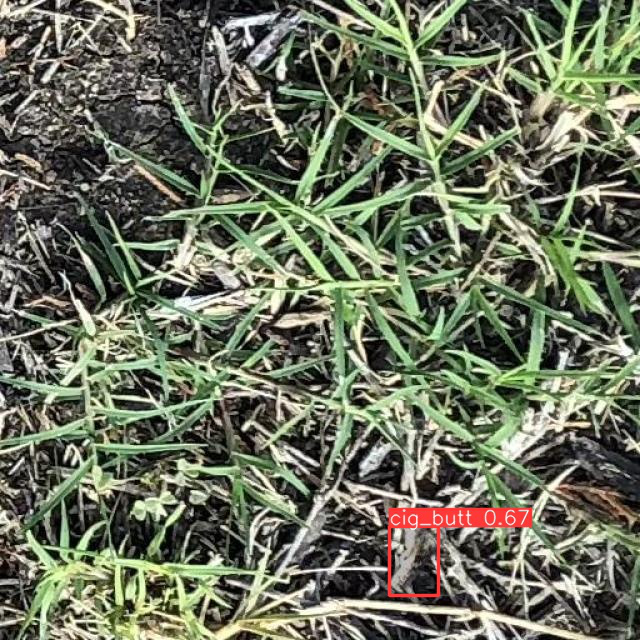

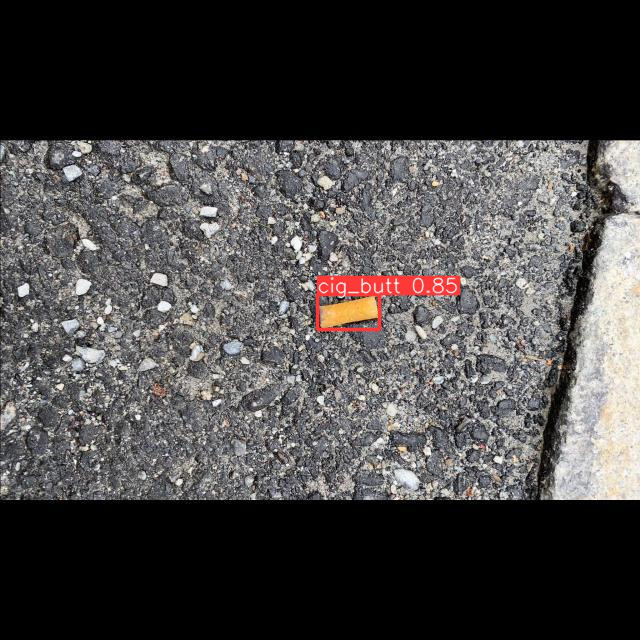

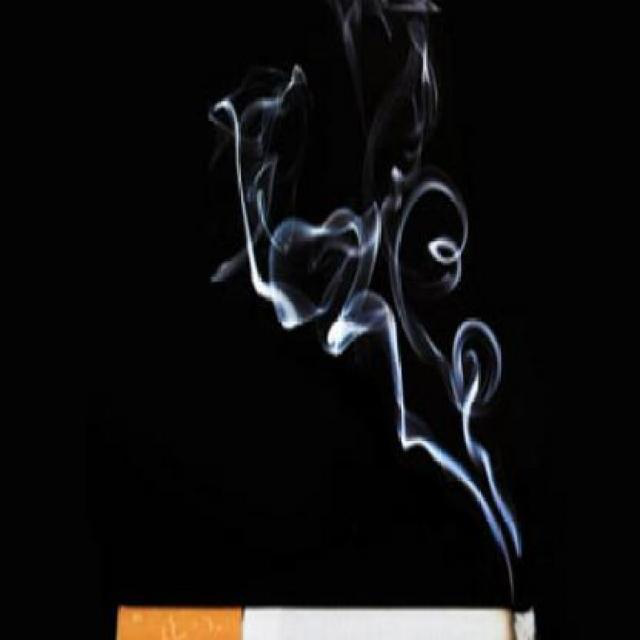

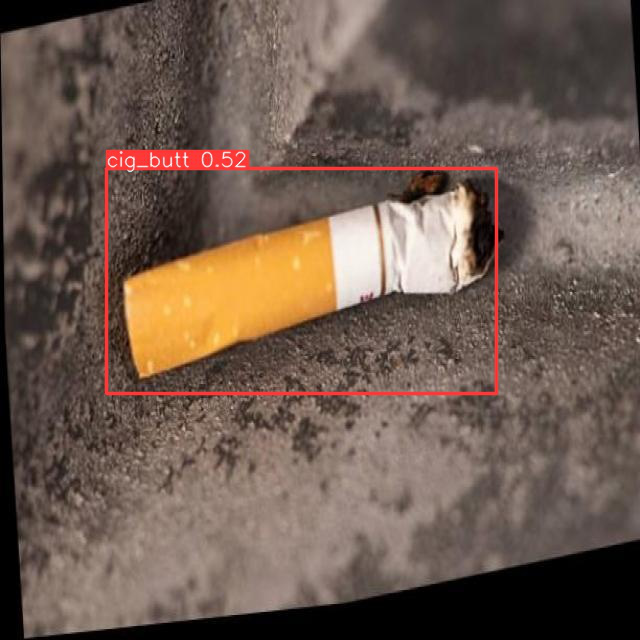

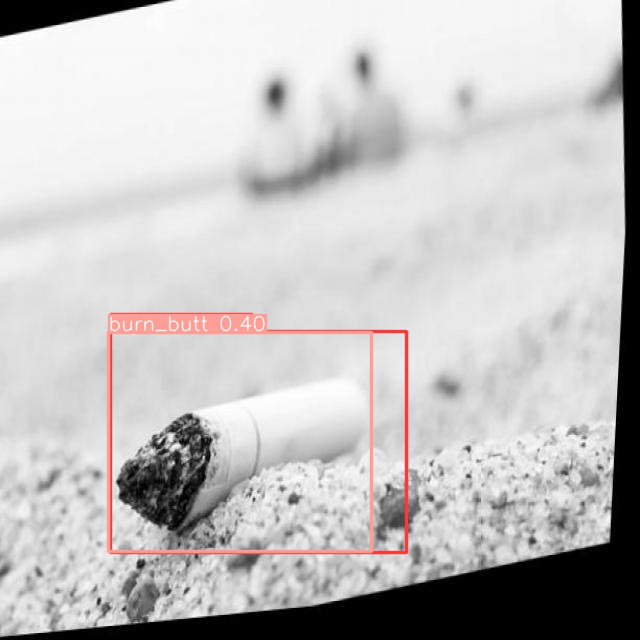

...

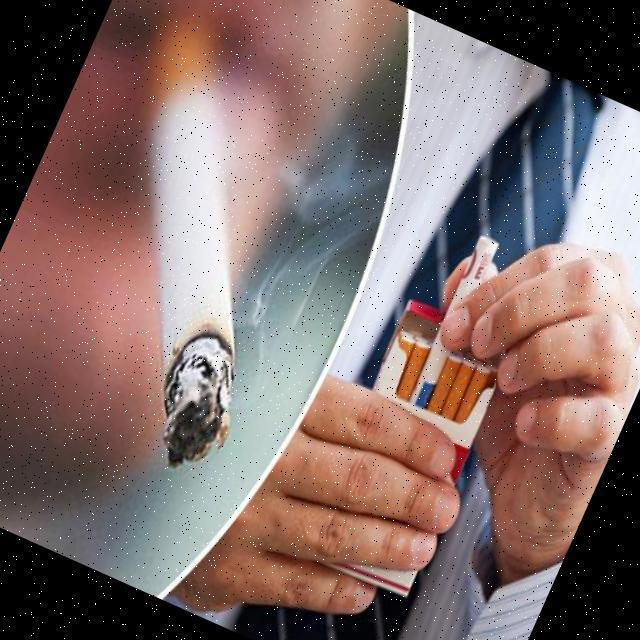

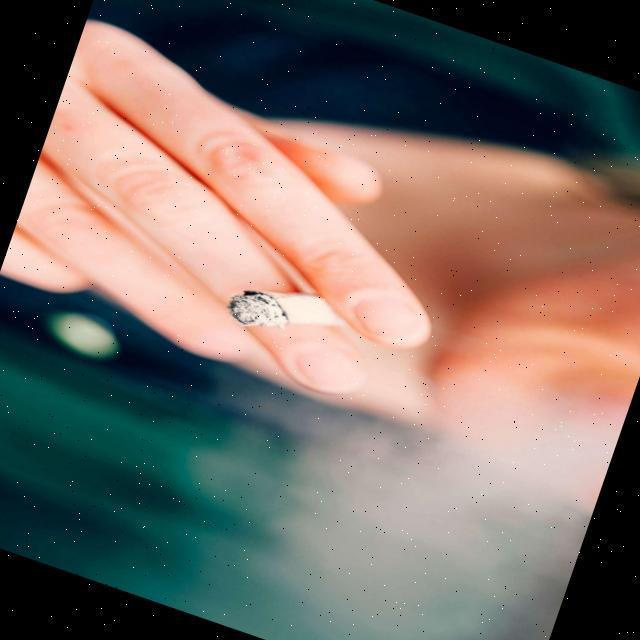

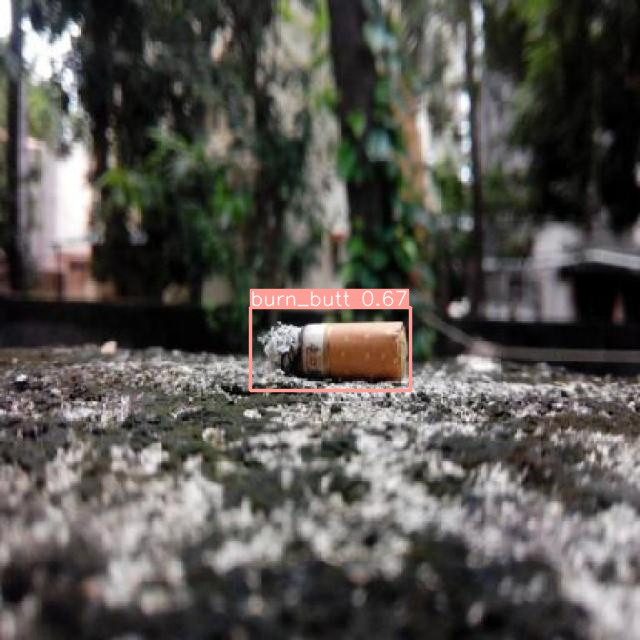

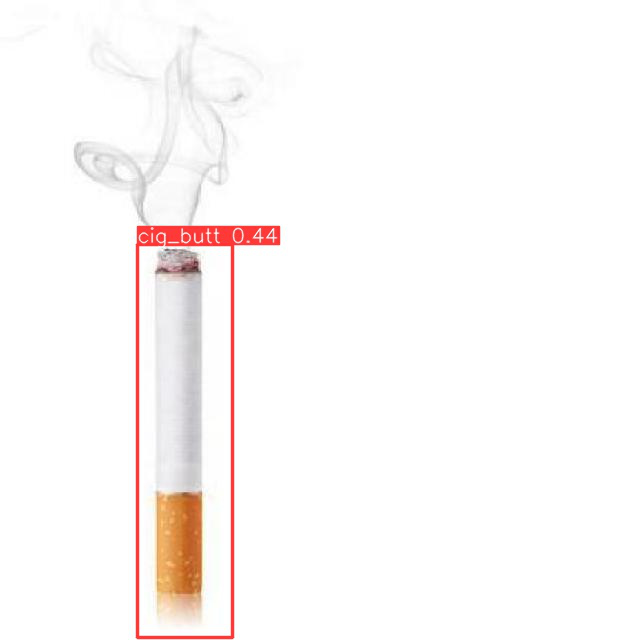

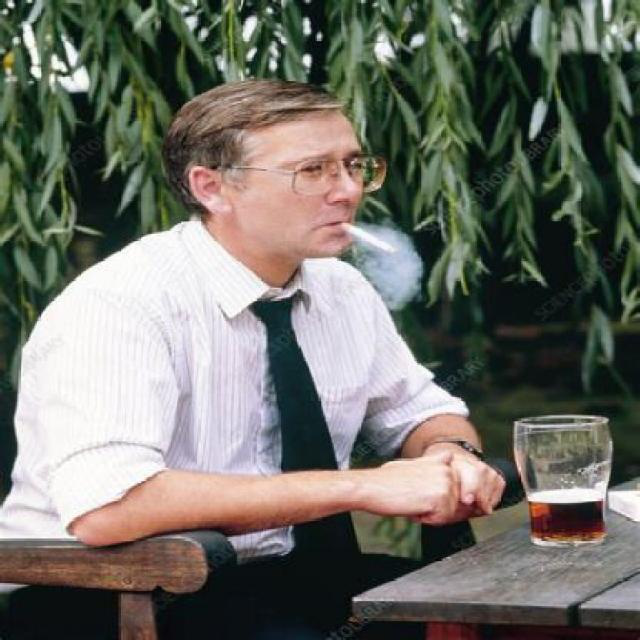

confidence 평균 :  0.7825753845012172

맞춘 경우 IOU값 평균 :  0.7700418095635401
맞춘 수 :  748
틀린 수 :  19
인식 못한 수 :  22


In [27]:
import numpy as np

rersult_conf = []
result_IOU = []
correct = 0
wrong = 0
no_view = 0


for result in results:
    if len(result.boxes) > 0:
        result_label = result.boxes.xywhn[0].tolist()
        #open_and_display_image(result.path)
        result_txt = os.path.join(test_dir, "labels/" + (os.path.splitext(os.path.basename(result.path))[0]) + ".txt")

        box_txt = read_and_print_text_file(result_txt)
        box_label = convert_strings_to_floats(box_txt[1])
        
        #print(result_label)
        #print(box_label)
        #print(box_txt[0], int(result.boxes.cls[0]))
        
        rersult_conf.append(float(result.boxes.conf[0]))
        
        if (int(box_txt[0]) == int(result.boxes.cls[0])):
            result_IOU.append(IoU(result_label, box_label))
            correct+=1
        else:
            wrong +=1
            path = image_dir + "/" + os.path.splitext(os.path.basename(result.path))[0] + ".jpg"
            with Image.open(path) as img:
                    display(img)
    else:
        no_view +=1        
        path = image_dir + "/" + os.path.splitext(os.path.basename(result.path))[0] + ".jpg"
        with Image.open(path) as img:
                display(img)

print("confidence 평균 : ", np.mean(rersult_conf))
print()
print("맞춘 경우 IOU값 평균 : ", np.mean(result_IOU))
print("맞춘 수 : ",  correct)
print("틀린 수 : ", wrong)
print("인식 못한 수 : ", no_view)